<a href="https://colab.research.google.com/github/jkcg-learning/AIEng_R40529/blob/main/Technical%20Excercise.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# Task : Create a two class classifier : Field & Road

- Jyothish CHANDRASENAN

# Checking the GPU Machine and CUDA Version

In [1]:
!nvcc --version
!nvidia-smi
!gcc -v

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
Thu Apr 20 17:06:44 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P8    13W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |       

In [2]:
!python --version

Python 3.9.16


In [3]:
import tensorflow as tf
from tensorflow import keras
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

print("Tensorflow Version: ", tf.version.VERSION)
print("Keras Version: ", keras.__version__)

Found GPU at: /device:GPU:0
Tensorflow Version:  2.12.0
Keras Version:  2.12.0


# Download Dataset

In [4]:
### using gdown downlaod the dataset from the good drive

!gdown 1pOKhKzIs6-oXv3SlKrzs0ItHI34adJsT

Downloading...
From: https://drive.google.com/uc?id=1pOKhKzIs6-oXv3SlKrzs0ItHI34adJsT
To: /content/dataset.zip
100% 15.4M/15.4M [00:02<00:00, 6.78MB/s]


In [5]:
!mkdir bilberry_dataset
!unzip /content/dataset.zip -d bilberry_dataset 

Archive:  /content/dataset.zip
   creating: bilberry_dataset/dataset/
   creating: bilberry_dataset/dataset/roads/
  inflating: bilberry_dataset/dataset/roads/42.jpg  
  inflating: bilberry_dataset/dataset/roads/37.jpg  
  inflating: bilberry_dataset/dataset/roads/40.jpg  
  inflating: bilberry_dataset/dataset/roads/38.jpg  
  inflating: bilberry_dataset/dataset/roads/10.jpg  
  inflating: bilberry_dataset/dataset/roads/41.jpg  
  inflating: bilberry_dataset/dataset/roads/39.jpg  
  inflating: bilberry_dataset/dataset/roads/1.jpg  
  inflating: bilberry_dataset/dataset/roads/44.jpg  
  inflating: bilberry_dataset/dataset/roads/2.jpg  
  inflating: bilberry_dataset/dataset/roads/43.jpg  
  inflating: bilberry_dataset/dataset/roads/11.jpg  
  inflating: bilberry_dataset/dataset/roads/3.jpg  
  inflating: bilberry_dataset/dataset/roads/12.jpg  
  inflating: bilberry_dataset/dataset/roads/4.jpg  
  inflating: bilberry_dataset/dataset/roads/13.jpg  
  inflating: bilberry_dataset/dataset/roa

In [6]:
import numpy as np 
import pandas as pd 


import os
for dirname, _, filenames in os.walk('/content/bilberry_dataset/dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/bilberry_dataset/dataset/roads/47.jpeg
/content/bilberry_dataset/dataset/roads/pexels-photo-1496372.jpeg
/content/bilberry_dataset/dataset/roads/45.jpg
/content/bilberry_dataset/dataset/roads/pexels-photo-1808329.jpeg
/content/bilberry_dataset/dataset/roads/35.jpg
/content/bilberry_dataset/dataset/roads/pexels-photo-59512.jpeg
/content/bilberry_dataset/dataset/roads/road-6597404__340.jpg
/content/bilberry_dataset/dataset/roads/6.jpg
/content/bilberry_dataset/dataset/roads/pexels-photo-1955134.jpeg
/content/bilberry_dataset/dataset/roads/pexels-photo-2568025.jpeg
/content/bilberry_dataset/dataset/roads/fog-6696312__340.jpg
/content/bilberry_dataset/dataset/roads/16.jpg
/content/bilberry_dataset/dataset/roads/pexels-photo-3593923.jpeg
/content/bilberry_dataset/dataset/roads/7.jpg
/content/bilberry_dataset/dataset/roads/4.jpg
/content/bilberry_dataset/dataset/roads/41.jpg
/content/bilberry_dataset/dataset/roads/13.jpg
/content/bilberry_dataset/dataset/roads/23.jpg
/content/bilber

# Create the below folder structure for classification problem

 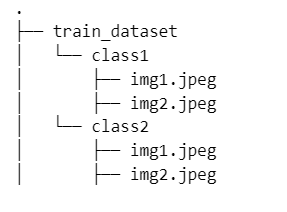

In [7]:
# Defining the working directories

work_dir = '/content/bilberry_dataset'
os.listdir(work_dir) 


['dataset']

In [8]:
!mkdir -p /content/bilberry_dataset/train/fields
!mkdir -p /content/bilberry_dataset/train/roads

In [9]:
!cp -R /content/bilberry_dataset/dataset/fields /content/bilberry_dataset/train/fields
!cp -R /content/bilberry_dataset/dataset/roads /content/bilberry_dataset/train/roads

# Import the necessary libraries and modules

In [10]:
#from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D,MaxPooling2D,GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.layers import Dense, Dropout, Flatten, Activation
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, CategoricalCrossentropy, BinaryCrossentropy
from tensorflow.keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint , ReduceLROnPlateau, CSVLogger
from tensorflow.keras.preprocessing.image import ImageDataGenerator


#Helper libraries
import random
import matplotlib.pyplot as plt
import datetime


print("Tensorflow Version : ",tf.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
#tf.config.experimental.set_memory_growth(physical_devices[0], True)
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except ValueError:
    strategy = tf.distribute.get_strategy() # default strategy that works on CPU and single GPU
print("Number of accelerators: ", strategy.num_replicas_in_sync)



Tensorflow Version :  2.12.0
Num GPUs Available:  1
Number of accelerators:  1


# Load and visualize the data

In [11]:

import cv2
IMG_SIZE = 512 ## specify the image reshape size to 512
COLOR_CHANNEL = 3

In [12]:
train_path = work_dir+'/train'

In [13]:
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(
                                      directory= train_path,
                                      image_size=(IMG_SIZE,IMG_SIZE),
                                      batch_size=16
                                      )

Found 153 files belonging to 2 classes.


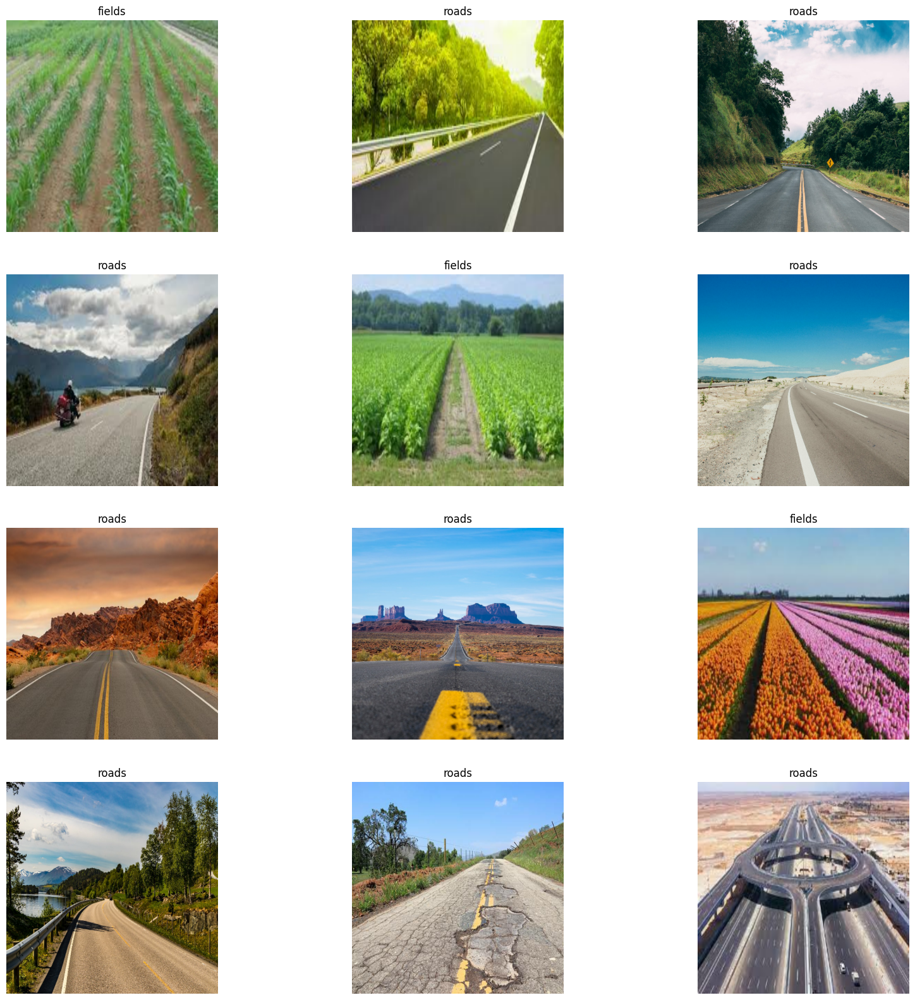

In [14]:
class_names = train_dataset.class_names
plt.figure(figsize=(20, 20))
for images, labels in train_dataset.take(1):
  for i in range(12):
    ax = plt.subplot(4, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

# Apply data augmentation for the train dataset and visualize the dataset

In [15]:
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255, # rescaling. Standardizing input to lie within [0, 1] range helps gradient descent based optimizations to converge faster i.e., it speeds up the training
                                   rotation_range = 40,  # Degree range for random rotations
                                   width_shift_range = 0.2,
                                   validation_split = 0.2,# 80/20 division between training and validation set
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2, #Range for random zoom
                                   horizontal_flip = True) #Randomly flip inputs horizontally. 


val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255, validation_split = 0.2)       

In [16]:
train_generator = train_datagen.flow_from_directory(directory= train_path,
                                                    batch_size = 16,
                                                    subset="training",
                                                    seed=42,
                                                    shuffle=True,
                                                    color_mode= 'rgb',
                                                    class_mode = 'binary', 
                                                    target_size = (IMG_SIZE,IMG_SIZE))

val_generator = val_datagen.flow_from_directory(directory = train_path,
                                                    batch_size = 16,
                                                    subset = "validation",
                                                    seed=42,
                                                    shuffle=True,
                                                    color_mode= 'rgb',
                                                    class_mode = 'binary', 
                                                    target_size = (IMG_SIZE,IMG_SIZE))

Found 123 images belonging to 2 classes.
Found 30 images belonging to 2 classes.


In [17]:
train_generator.class_indices

{'fields': 0, 'roads': 1}

In [18]:
val_generator.class_indices

{'fields': 0, 'roads': 1}

In [19]:
class_dict = {y: x for x, y in train_generator.class_indices.items()}
class_dict

{0: 'fields', 1: 'roads'}

# Observe the number of images in each classes

### the dataset seems to be imbalanced as there are 36 samples for "fields" category and 87 samples for "roads" category.

### So calculate class_weights for each category 

In [20]:
from collections import Counter

counter = Counter(train_generator.classes)

print(counter.items())

dict_items([(0, 36), (1, 87)])


In [21]:
total_train_samples = counter[0] + counter[1]
total_train_samples

123

In [22]:
class_weights_bilberry = {}
i= 0


for key in train_generator.class_indices.keys():
    # print(key)
    #print(count_sports[key])
    class_weights_bilberry[i] = total_train_samples / (2 * counter[train_generator.class_indices[key]])
    i+=1

class_weights_bilberry 

{0: 1.7083333333333333, 1: 0.7068965517241379}

In [23]:
def plot_images(data_generator=None):
    plt.figure(figsize=(20, 20))
    if data_generator is not None:
        images,labels=data_generator.next()
        for i in range(12):
            ax = plt.subplot(4, 3, i + 1)
            images[i,:,:,:]=images[i,:,:,:]*255.0
            plt.xticks([])
            plt.yticks([])
            plt.imshow(images[i,:,:,:].astype("uint8"))
          
            plt.title(class_dict[labels[i]])
            plt.xlabel("Class label: "+str(labels[i].astype(int)))
            
            
            #plt.axis("off")

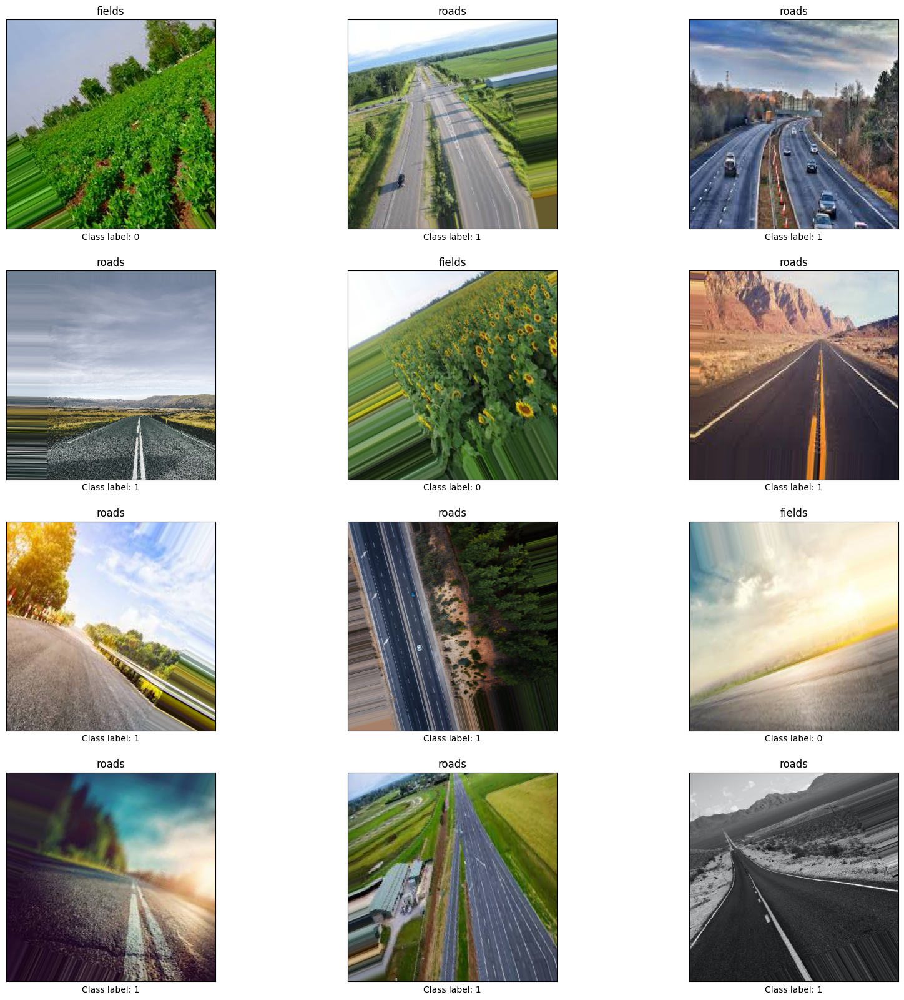

In [24]:
plot_images(train_generator)

# Model 1 

### CNN Model - 3 convolutional blocks and 2 Fully Connected Layers

- Activation Function : Relu
- Optimizer : Adam
- Loss Function : SparseCategoricalCrossEntropy
- Metrics : Accuracy
- Callbacks : callbacks = [checkPoint_callback, earlyStopping_callback, learningRate_callback,tensorBoard_callback, csvLogger_callback]
- Epochs : 100 (early stopping , patience : 10)
- Batch SIze : 16

In [25]:
input_shape=(IMG_SIZE,IMG_SIZE,COLOR_CHANNEL)

In [26]:
model_CNN = Sequential()# sequential 

# 1 - Convolution

model_CNN.add(Conv2D(64,(3,3), padding='same', input_shape=input_shape)) #The convolution layer has 64 filters with a 3 x 3 kernel.  Pads extra pixels around the image to keep the original dimension(padding='same')
model_CNN.add(Activation('relu'))#We are using RELU as the activation function.
model_CNN.add(MaxPooling2D(pool_size=(2, 2))) #Reducing volume size by max pooling
model_CNN.add(Dropout(0.2)) ## Applied dropout to avoid overfitting


# 2nd Convolution layer
model_CNN.add(Conv2D(32,(3,3), padding='same')) #The convolution layer has 32 filters with a 5 x 5 kernel. We are using RELU the activation function
model_CNN.add(Activation('relu'))
model_CNN.add(MaxPooling2D(pool_size=(2, 2))) 
model_CNN.add(Dropout(0.2))


# 3rd Convolution layer
model_CNN.add(Conv2D(16,(3,3), padding='same'))  #The convolution layer has 16 filters with a 3 x 3 kernel. We are using RELU the activation function
model_CNN.add(Activation('relu'))
model_CNN.add(MaxPooling2D(pool_size=(2, 2)))


# Flattening
model_CNN.add(Flatten()) #Flattening the output from the 3rd Convolution layer

# 1st Fully connected layer. Fully-connected layers at the end of the network prior to a softmax classifier  
model_CNN.add(Dense(256))# 256 units in this hidden layer
model_CNN.add(Activation('relu'))
model_CNN.add(Dropout(0.2))

# 2nd Fully connected layer. Fully-connected layers at the end of the network prior to a softmax classifier
model_CNN.add(Dense(256))# 256 units in this hidden layer
model_CNN.add(Activation('relu'))


model_CNN.add(Dense(2, activation='softmax')) # 2 units for 2 classes , using softmax as the activation function

model_CNN.compile(optimizer = 'Adam', loss= SparseCategoricalCrossentropy(), metrics='accuracy')
model_CNN.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 512, 512, 64)      1792      
                                                                 
 activation (Activation)     (None, 512, 512, 64)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 256, 256, 64)     0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 256, 256, 64)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 256, 256, 32)      18464     
                                                                 
 activation_1 (Activation)   (None, 256, 256, 32)      0         
                                                        

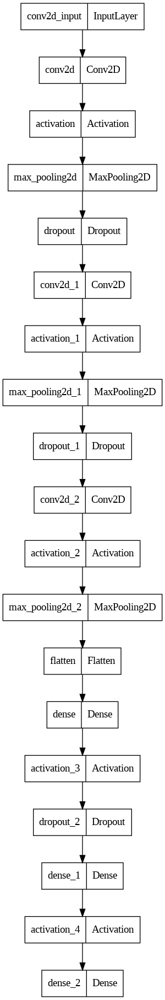

In [27]:
keras.utils.plot_model(model_CNN)

### Create proper callbacks and logging mechanism 

In [28]:
logging_directory = os.path.join("bilberry_classification", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
csv_filename = logging_directory+"/log.csv"
checkpoint_filename = logging_directory+"/best_weights_CNN.h5"

In [29]:


checkPoint_callback = ModelCheckpoint(
    filepath = checkpoint_filename,
    monitor="val_loss",
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode="auto"
)

earlyStopping_callback = EarlyStopping(
    monitor="val_loss",
    min_delta=0.001,
    patience=10,
    verbose=1,
    mode="auto",
    restore_best_weights=True,
)

learningRate_callback = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.1,
    patience=4,
    verbose=1,
    mode="auto",
    min_delta=0.001,
)

tensorBoard_callback = TensorBoard(
    log_dir = logging_directory,
    write_graph=True, 
    write_images=True,
    update_freq='epoch',
    histogram_freq=1)


csvLogger_callback= CSVLogger(
    filename = csv_filename,
    separator=',', 
    append=True
    )

### Train the CNN model

In [30]:
EPOCHS = 100
BATCH_SIZE = 16

history_CNN = model_CNN.fit(train_generator,
                    validation_data = val_generator,
                    batch_size=BATCH_SIZE,
                    # steps_per_epoch=(len(train_generator)*0.8) // BATCH_SIZE,
                    # validation_steps=(len(val_generator)*0.2) // BATCH_SIZE,
                    callbacks = [checkPoint_callback, earlyStopping_callback, learningRate_callback,tensorBoard_callback, csvLogger_callback], 
                    epochs=EPOCHS,
                    class_weight = class_weights_bilberry,
                    verbose=1)


Epoch 1/100
8/8 [==============================] - ETA: 0s - loss: 6.3504 - accuracy: 0.4959
Epoch 1: val_loss improved from inf to 0.66706, saving model to bilberry_classification/20230420-170713/best_weights_CNN.h5
8/8 [==============================] - 39s 3s/step - loss: 6.3504 - accuracy: 0.4959 - val_loss: 0.6671 - val_accuracy: 0.8333 - lr: 0.0010
Epoch 2/100
8/8 [==============================] - ETA: 0s - loss: 0.6849 - accuracy: 0.4309
Epoch 2: val_loss improved from 0.66706 to 0.64555, saving model to bilberry_classification/20230420-170713/best_weights_CNN.h5
8/8 [==============================] - 16s 2s/step - loss: 0.6849 - accuracy: 0.4309 - val_loss: 0.6455 - val_accuracy: 0.7000 - lr: 0.0010
Epoch 3/100
8/8 [==============================] - ETA: 0s - loss: 0.6522 - accuracy: 0.5610
Epoch 3: val_loss did not improve from 0.64555
8/8 [==============================] - 17s 2s/step - loss: 0.6522 - accuracy: 0.5610 - val_loss: 0.6643 - val_accuracy: 0.6667 - lr: 0.0010
Ep

### Plot the loss and accuracy curves

In [53]:
# plotting helper function
def plotaccuracy(hist):
    plt.plot(hist.history['val_accuracy'])
    plt.plot(hist.history['accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['validation', 'train'], loc='upper left')
    plt.show()

In [32]:
# plotting helper function
def plotloss(hist):
    plt.plot(hist.history['val_loss'])
    plt.plot(hist.history['loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['validation', 'train'], loc='upper left')
    plt.show()

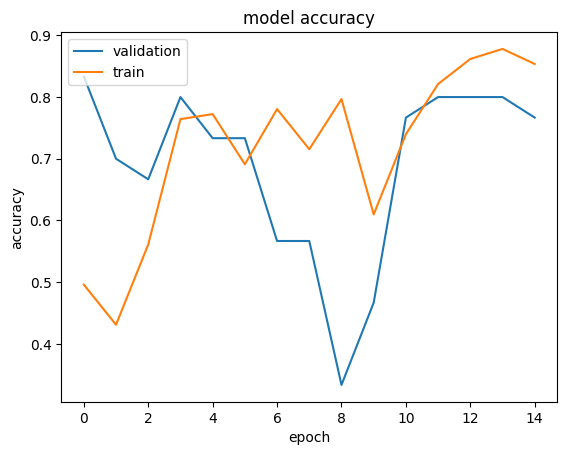

In [54]:
plotaccuracy(history_CNN)

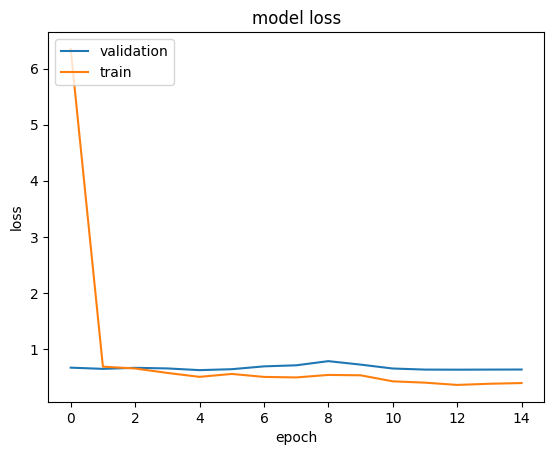

In [34]:
plotloss(history_CNN)

### Open the tensorboard and visualize the results from logs

In [35]:
!kill 3000
#Run TensorBord in Google Colab
%load_ext tensorboard
%tensorboard --port=3000 --logdir $logging_directory

/bin/bash: line 0: kill: (3000) - No such process


<IPython.core.display.Javascript object>

### As we don't have a very good result with the normal CNN architecture, let us try training using Transfer Learning techniques

# Model 2

### Transfer Learning using VGG19 + 3 Fully connected Layers

- Transfer Learning :  VGG19
- Activation Function : Relu
- Optimizer : Adam
- Loss Function : SparseCategoricalCrossEntropy
- Metrics : Accuracy
- Callbacks : callbacks = [checkPoint_callback, earlyStopping_callback, learningRate_callback,tensorBoard_callback, csvLogger_callback]
- Epochs : 100 (early stopping , patience : 10)
- Batch SIze : 16


In [36]:
train_datagen = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg19.preprocess_input, ## use the VGG19 preprocessing
                                   rotation_range = 40,  # Degree range for random rotations
                                   width_shift_range = 0.2,
                                   validation_split = 0.2,# 80/20 division between training and validation set
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.05, #Range for random zoom
                                   horizontal_flip = True) #Randomly flip inputs horizontally.

val_datagen = ImageDataGenerator(preprocessing_function=tf.keras.applications.vgg19.preprocess_input,
                                 validation_split = 0.2)

train_generator = train_datagen.flow_from_directory(directory= train_path,
                                                    batch_size = 16,
                                                    subset="training",
                                                    seed=42,
                                                    shuffle=True,
                                                    color_mode= 'rgb',
                                                    class_mode = 'binary', 
                                                    target_size = (IMG_SIZE,IMG_SIZE))

val_generator = val_datagen.flow_from_directory(directory = train_path,
                                                    batch_size = 16,
                                                    subset = "validation",
                                                    seed=42,
                                                    shuffle=True,
                                                    color_mode= 'rgb',
                                                    class_mode = 'binary', 
                                                    target_size = (IMG_SIZE,IMG_SIZE))

Found 123 images belonging to 2 classes.
Found 30 images belonging to 2 classes.


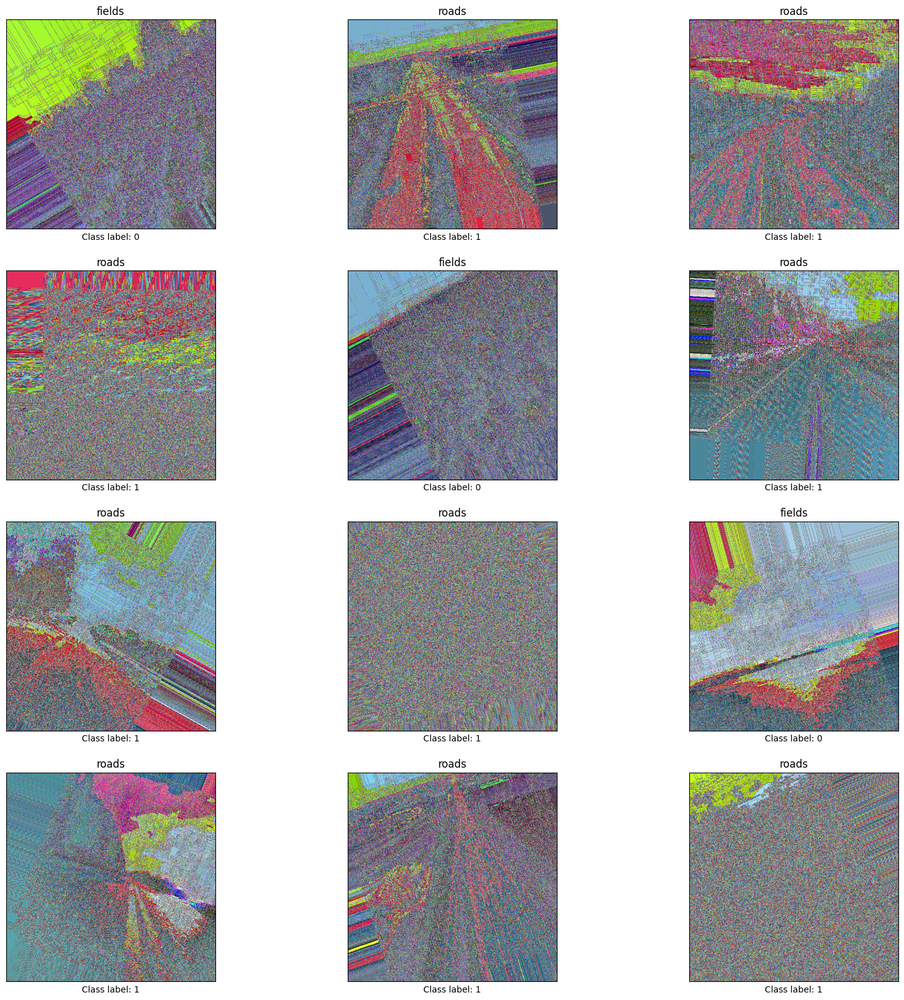

In [37]:
plot_images(train_generator)

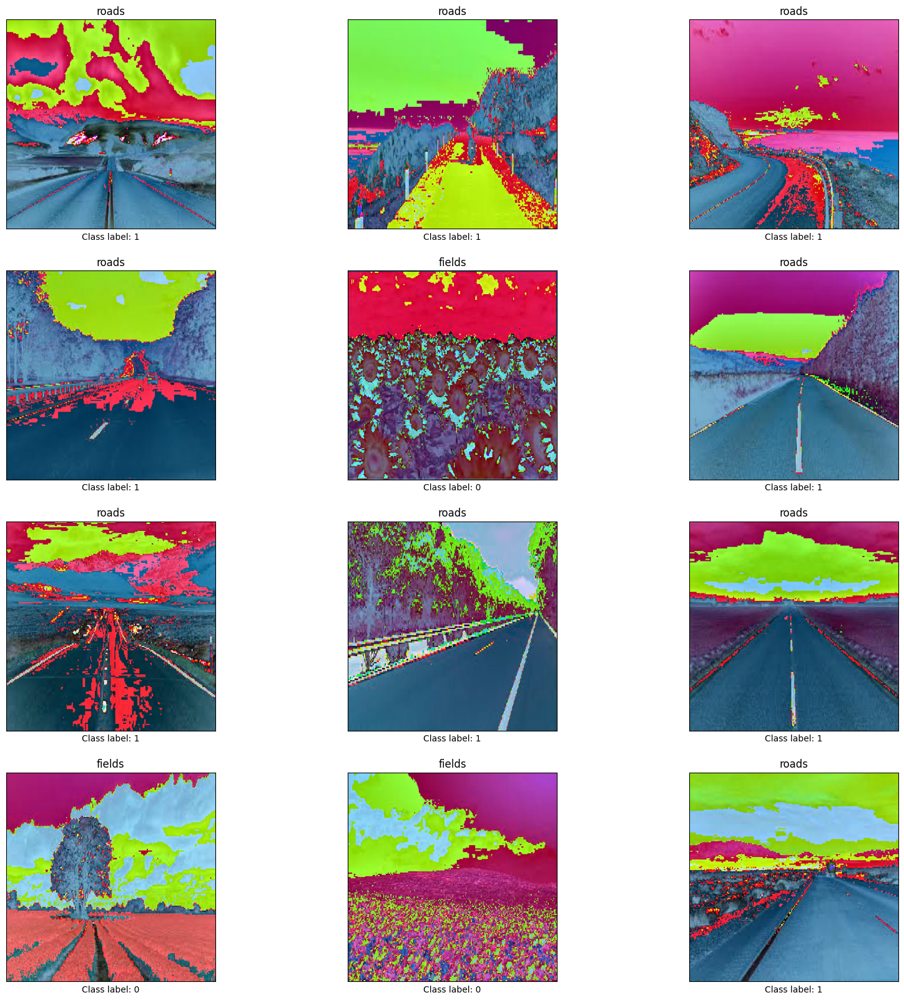

In [38]:
plot_images(val_generator)

In [39]:
# define input shape
INPUT_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

model_layers = keras.applications.VGG19(weights='imagenet', include_top=False, #include_preprocessing=True,
                                               input_shape=INPUT_SHAPE)
model_layers.summary()

80134624/80134624 [==============================] - 5s 0us/step
Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 512, 512, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 512, 512, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 512, 512, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 256, 256, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 256, 256, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 256, 256, 128)     147584    
                                                              

In [40]:
# Fine-tune all the layers
for layer in model_layers.layers:
    layer.trainable = False
# Check the trainable status of the individual layers
for layer in model_layers.layers:
    print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x7f0b935f5130> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b9366c220> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b8e1b9be0> False
<keras.layers.pooling.max_pooling2d.MaxPooling2D object at 0x7f0b93605190> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b9366c9a0> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b93605b50> False
<keras.layers.pooling.max_pooling2d.MaxPooling2D object at 0x7f0b9360ad90> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b93611a90> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b93611f10> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b93605550> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b93605520> False
<keras.layers.pooling.max_pooling2d.MaxPooling2D object at 0x7f0b93618d60> False
<keras.layers.convolutional.conv2d.Conv2D object at 0x7f0b935f6d00> False
<keras.layers.convolut

In [41]:
# define sequential model
model_TransferLearning = Sequential()

# Add the Resnet convolutional base model
model_TransferLearning.add(model_layers)
model_TransferLearning.add(GlobalAveragePooling2D())
# model_TransferLearning.add(Flatten())



# Fully connected 1st layer
model_TransferLearning.add(Dense(256))
model_TransferLearning.add(Activation('relu'))
model_TransferLearning.add(Dropout(0.20))

# Fully connected 2nd layer
model_TransferLearning.add(Dense(128))
model_TransferLearning.add(Activation('relu'))
model_TransferLearning.add(Dropout(0.20))

model_TransferLearning.add(Dense(64))
model_TransferLearning.add(Activation('relu'))

model_TransferLearning.add(Dense(2, activation='softmax'))
#model_ResNet.add(Dense(35))
#SparseCategoricalCrossentropy(from_logits=True)
# compile model
model_TransferLearning.compile(optimizer = 'Adam', loss= SparseCategoricalCrossentropy(), metrics='accuracy')

# view model layers
model_TransferLearning.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 16, 16, 512)       20024384  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dense_3 (Dense)             (None, 256)               131328    
                                                                 
 activation_5 (Activation)   (None, 256)               0         
                                                                 
 dropout_3 (Dropout)         (None, 256)               0         
                                                                 
 dense_4 (Dense)             (None, 128)               32896     
                                                      

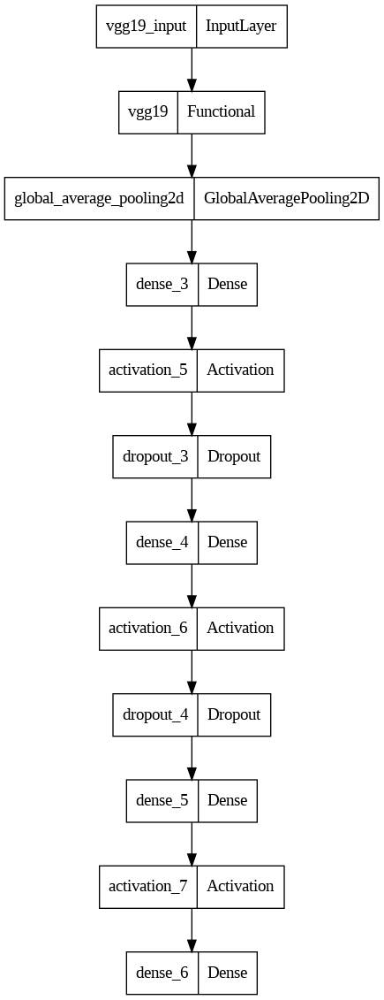

In [42]:
keras.utils.plot_model(model_TransferLearning)

In [43]:
logging_directory = os.path.join("bilberry_classification", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
csv_filename = logging_directory+"/log.csv"
checkpoint_filename = logging_directory+"/best_weights_TL_VGG19.h5"

In [44]:


checkPoint_callback = ModelCheckpoint(
    filepath = checkpoint_filename,
    monitor="val_loss",
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode="auto"
)

earlyStopping_callback = EarlyStopping(
    monitor="val_loss",
    min_delta=0.001,
    patience=10,
    verbose=1,
    mode="auto",
    restore_best_weights=True,
)

learningRate_callback = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.1,
    patience=4,
    verbose=1,
    mode="auto",
    min_delta=0.001,
)

tensorBoard_callback = TensorBoard(
    log_dir = logging_directory,
    write_graph=True, 
    write_images=True,
    update_freq='epoch',
    histogram_freq=1)


csvLogger_callback= CSVLogger(
    filename = csv_filename,
    separator=',', 
    append=True
    )

In [45]:
EPOCHS = 100
BATCH_SIZE = 16

history = model_TransferLearning.fit(train_generator,
                    validation_data = val_generator,
                    batch_size=BATCH_SIZE,
                    # steps_per_epoch=(len(train_data)*0.8) // BATCH_SIZE,
                    # validation_steps=(len(train_data)*0.2) // BATCH_SIZE,
                    callbacks = [checkPoint_callback, earlyStopping_callback, learningRate_callback,tensorBoard_callback, csvLogger_callback], 
                    epochs=EPOCHS,
                    class_weight = class_weights_bilberry,
                    verbose=1)


Epoch 1/100
8/8 [==============================] - ETA: 0s - loss: 0.9939 - accuracy: 0.6341
Epoch 1: val_loss improved from inf to 0.44715, saving model to bilberry_classification/20230420-171220/best_weights_TL_VGG19.h5
8/8 [==============================] - 43s 4s/step - loss: 0.9939 - accuracy: 0.6341 - val_loss: 0.4472 - val_accuracy: 0.7667 - lr: 0.0010
Epoch 2/100
8/8 [==============================] - ETA: 0s - loss: 0.3482 - accuracy: 0.8455
Epoch 2: val_loss did not improve from 0.44715
8/8 [==============================] - 16s 2s/step - loss: 0.3482 - accuracy: 0.8455 - val_loss: 0.5400 - val_accuracy: 0.7000 - lr: 0.0010
Epoch 3/100
8/8 [==============================] - ETA: 0s - loss: 0.2304 - accuracy: 0.9187
Epoch 3: val_loss improved from 0.44715 to 0.26897, saving model to bilberry_classification/20230420-171220/best_weights_TL_VGG19.h5
8/8 [==============================] - 19s 3s/step - loss: 0.2304 - accuracy: 0.9187 - val_loss: 0.2690 - val_accuracy: 0.9000 - lr:

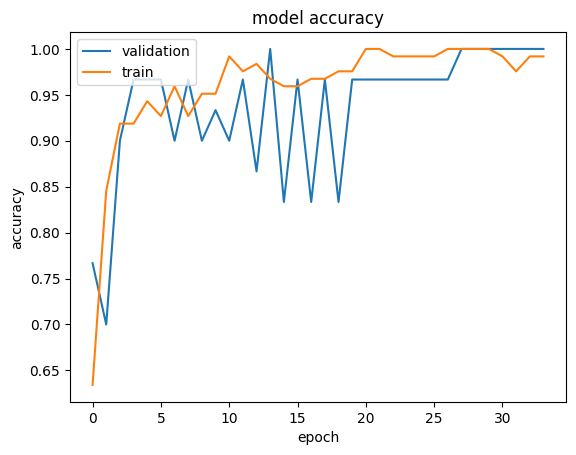

In [55]:
plotaccuracy(history)

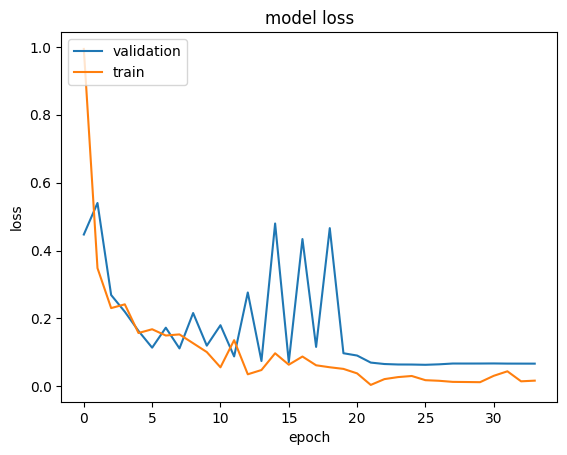

In [47]:
plotloss(history)

In [48]:
!kill 3001
#Run TensorBord in Google Colab
%load_ext tensorboard
%tensorboard --port=3001 --logdir $logging_directory

/bin/bash: line 0: kill: (3001) - No such process
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Training using transfer learning gave a very good result. So we can finalize this model to have inference on test dataset

In [49]:
model_final = model_TransferLearning

In [50]:
test_path = '/content/bilberry_dataset/dataset/test_images'  

1/1 [==============================] - 0s 23ms/step


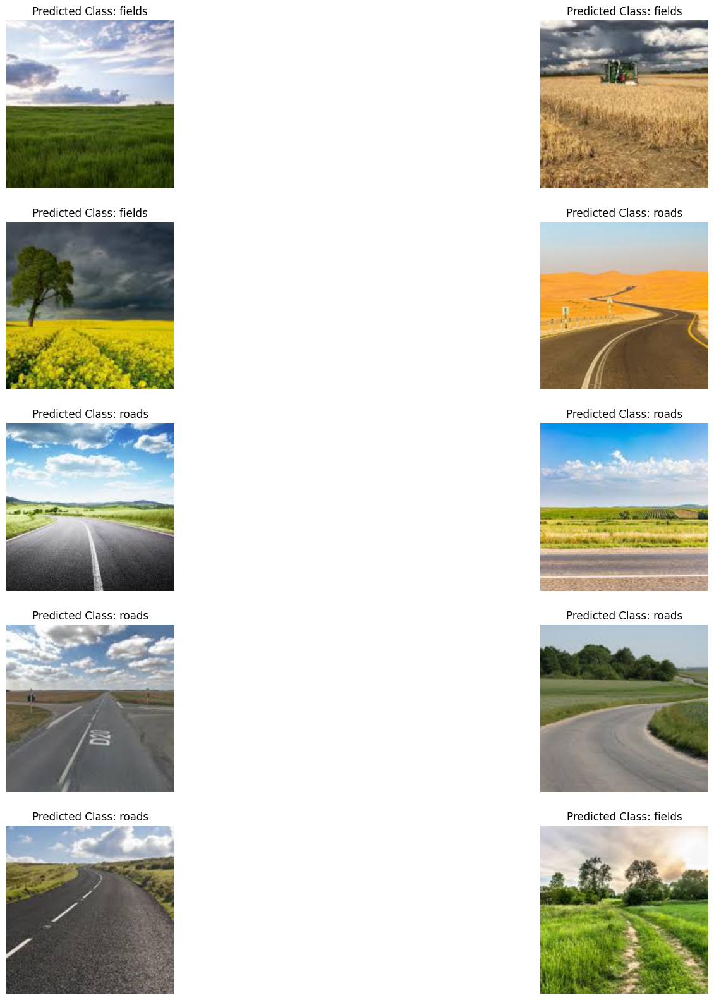

In [51]:
i = 0
plt.figure(figsize=(20, 20))
for img in os.listdir(test_path):

  ax = plt.subplot(5, 2, i + 1)

  img = os.path.join(test_path, img)
  img = keras.preprocessing.image.load_img(img)
  img = keras.preprocessing.image.img_to_array(img)
  img = keras.preprocessing.image.smart_resize(img, (IMG_SIZE, IMG_SIZE))

  plt.imshow(img.astype("uint8"))
  plt.axis("off")

  img = tf.keras.applications.vgg19.preprocess_input(img)

  img = tf.reshape(img,[1 ,IMG_SIZE,IMG_SIZE,3])
  prediction_score = model_final.predict(img)
  prediction_class = np.argmax(prediction_score)


  predicted_class_category = class_dict[prediction_class]
  plt.title("Predicted Class: "+str(predicted_class_category))
  
  i+=1

